# 🎹🎻🥁
# **Jazzing Beyond Borders: Unlocking Multilingual Potential with Rhythm Analysis**
*proof of concept by: Clarence Karanja & Yvonne Njeri*  (Final year Statistics & Computer Science students @ Technical university of Mombasa)

**What We're Doing:**
We are studying how jazz music's rhythm patterns can help make speech recognition work better for different languages and accents.

**Why We're Doing It:**
We want to improve the way computers understand and recognize different languages when people speak. Jazz rhythms have interesting patterns that can be used to make this process more accurate, helping people from various backgrounds communicate more effectively.

**DETAILED EXPLANATION OF OUR PROCEDURE**

1. **Import Dependencies and Set Constants**:
At the beginning, we gather all the necessary tools and establish some specific rules and values that we'll use throughout the project. This includes software libraries and fixed numbers that guide our analysis.

2. **Load and Separate Audio**:
We take a piece of music, such as a portion of a jazz song, and process it to split it into separate tracks for each musical instrument. In this case, we're typically interested in the piano, bass, and drums.

3. **Finding the Musical Beats**:
We create a tempo map by studying the music to determine where the strong beats or rhythmic pulses occur. This map helps us understand the underlying rhythm of the music.

4. **Detect Individual Onsets**:
We closely examine each instrument track to pinpoint the exact moments when individual notes or sounds begin. It's akin to identifying when a musician starts playing a single note or sound on their instrument. This information is crucial for understanding the rhythm and timing of the performance.

5. **Data Formatting for Modeling**:
We organize and format the data collected in the previous steps in a way that's suitable for computer modeling and analysis. This step involves aligning the estimated beat positions with the detected note onsets for each instrument.

6. **Generate Phase Correction Model**:
Here, we create a special mathematical model that helps us analyze how the musicians interact with each other rhythmically. This model allows us to understand the intricate details of their timing and coordination.

7. **Extract Coupling Coefficients**:
From our model, we extract specific coefficients that represent how closely the musicians are synchronized with each other. These coefficients provide quantitative measures of their rhythmic interaction.

8. **Visualize the Degree of Coupling**:
Finally, we use these coefficients to create visual representations or charts that illustrate the level of synchronization and coordination among the musicians. These visuals help us better comprehend how well the musicians are working together in the jazz performance.

## Import Dependencies and Set Constants:

The following few cells we will;
1. Load Essential Tools
In this part, we're like chefs preparing our kitchen. We bring in all the tools we need to cook up our project. These tools are special software libraries that help us work with music, sounds, and data.
2. Define Constants
Think of constants as fixed values that don't change. It's like setting our recipe with specific measurements. We decide on some important numbers that we'll use over and over again in our project. These numbers are like the recipe instructions that help us make sense of the data and music later on.

In [ ]:
# We're setting up some folders to keep our Colab project outputs organized.
# Let's create a couple of folders to neatly store the results of our work in Colab.
!mkdir ./output/
!mkdir ./assets/

In [ ]:
# To use Spleeter, we have to install it first, along with FFmpeg.
# These tools aren't included with Colab out of the box, so we're adding them to our toolkit.
!apt install ffmpeg
!pip install spleeter

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 18 not upgraded.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.4/49.4 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.3/77.3 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.8/511.8 MB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 103.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 93.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 77.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 438.7/438.7

In [ ]:
from spleeter.separator import Separator
from IPython.display import Audio
import librosa
import librosa.display
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
import pandas as pd
import statsmodels.formula.api as smf

In [ ]:
np.set_printoptions(suppress=True)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [ ]:
# Describing the key characteristics of the audio we can use.
SAMPLE_RATE = 44100       #represents the sample rate of the audio
HOP_LENGTH = 512          #the hop length used for processing the audio signal
INPUT_AUDIO = "input.mp3" #the name or path of the input audio file

In [ ]:
# Selected Audio Separation Model
selected_model = "spleeter:5stems"

In [ ]:
# Tempo and Track Details
average_tempo = 180                  # The mean tempo of the track
min_tempo, max_tempo = 175, 185      # Minimum and maximum tempo values
tempo_deviation = 0.1                # The standard deviation of tempo
track_tightness = 2000               # Measure of how tight the track feels (subjective)
note_detection_threshold = 1/12      # Threshold for detecting a triplet quaver


## 2. Load and Separate Audio:

### **Loading Audio and Defining the Spleeter Model**

[*Spleeter*](https://github.com/deezer/spleeter) is a Python library for audio source separation, developed by Deezer, a popular streaming service. It is currently employed in professional audio software like [iZotope RX](https://www.izotope.com/en/products/rx.html) and [Steinberg Spectralayers](https://www.steinberg.net/spectralayers/). On the [MUSDB18 Source Separation leaderboard.](https://paperswithcode.com/sota/music-source-separation-on-musdb18), Spleeter ranks 16th among 25 entries.

Spleeter offers a range of pre-trained machine learning models, each capable of isolating different combinations of musical instruments. In this context, we are utilizing the 5stems model to separate the piano, bass, and drums from the stereo audio recording while excluding the vocals and other residual tracks. By default, Spleeter performs this separation up to 11kHz. However, it's important to note that with certain adjustments to the internal configuration files (although not recommended for online use), it can extend its capabilities up to 22kHz. For now, we are using the default settings, with the understanding that we may increase the sampling rate in our full implementation.

In [ ]:
# First, we need to pull in the audio file we're using for analysis from GitHub
!wget -O input.mp3 https://github.com/HuwCheston/source-seperation-test/raw/main/input.mp3

--2023-10-05 09:59:19--  https://github.com/HuwCheston/source-seperation-test/raw/main/input.mp3
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/HuwCheston/source-seperation-test/main/input.mp3 [following]
--2023-10-05 09:59:19--  https://raw.githubusercontent.com/HuwCheston/source-seperation-test/main/input.mp3
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 744020 (727K) [audio/mpeg]
Saving to: ‘input.mp3’

input.mp3           100%[===================>] 726.58K  --.-KB/s    in 0.007s  

2023-10-05 09:59:19 (104 MB/s) - ‘input.mp3’ saved [744020/744020]



In [ ]:
# Now we can load the full mix of the audio file in to Librosa.
full_mix, _ = librosa.load(
    INPUT_AUDIO,    # The filepath to our audio
    sr=SAMPLE_RATE,    # Our sample rate
    mono=False,    # Load the file in stereo, as we need both channels
    offset=0,    # Load the file from the very beginning
    duration=None,    # Don't trim the audio file
    dtype=np.float32    # Set the data type as a float for use in numpy
)

In [ ]:
# Now, we instantiate our Spleeter Separator instance.
# We use the model we specified as a constant earlier (i.e. 5stems)
separator = Separator(selected_model)

### Separating the Sounds

When we study recordings of piano trios, it's easier to understand because the instruments are placed in specific ways. For example, in this recording, the bass is on the right, the drums are on the left, and the piano is in the middle.

So, we can use this information to split the sounds. We separate each instrument's sound from the recording. It's like taking out the bass, drums, and piano, one by one. This way, we can focus on each instrument's sound individually.

By doing this, we can better understand how the musicians play together in the jazz trio.

In [ ]:
def extract_audio_channel(
    stereo_waveform: np.array, target_channel: int
) -> np.array:
    """
    Extracts the specified audio channel (0 for left, 1 for right) from a stereo audio source.

    Parameters:
        stereo_waveform (np.array): The stereo audio waveform.
        target_channel (int): 0 for the left channel or 1 for the right channel.

    Returns:
        np.array: The extracted mono audio waveform.
    """
    # Extract the desired audio channel and reshape it to mono
    extracted_channel = stereo_waveform[:, target_channel].reshape(-1, 1)

    # Duplicate the mono channel to create a stereo format
    return np.tile(extracted_channel, (1, 2))


In [ ]:
# Create an empty dictionary to hold our separated audio tracks.
prediction_for = {}

# Separate the drum audio by applying source separation to the left audio channel.
prediction_for['drums'] = separator.separate(extract_audio_channel(full_mix.T, 0))['drums']

# Separate the bass audio by applying source separation to the right audio channel.
prediction_for['bass'] = separator.separate(extract_audio_channel(full_mix.T, 1))['bass']

# Separate the piano audio by using both audio channels (center panned).
prediction_for['piano'] = separator.separate(full_mix.T)['piano']

INFO:spleeter:Downloading model archive https://github.com/deezer/spleeter/releases/download/v1.4.0/5stems.tar.gz


INFO:spleeter:Downloading model archive https://github.com/deezer/spleeter/releases/download/v1.4.0/5stems.tar.gz


INFO:spleeter:Validating archive checksum


INFO:spleeter:Validating archive checksum


INFO:spleeter:Extracting downloaded 5stems archive


INFO:spleeter:Extracting downloaded 5stems archive


INFO:spleeter:5stems model file(s) extracted


INFO:spleeter:5stems model file(s) extracted
Instructions for updating:
Use output_signature instead
Instructions for updating:
Use output_signature instead
Instructions for updating:
Colocations handled automatically by placer.


In [ ]:
# Now, we'll listen to the extracted drums audio to check if it sounds right.
Audio(prediction_for['drums'].T, rate=SAMPLE_RATE)

In [ ]:
# Now, we'll listen to the extracted bass audio to check if it sounds right.
Audio(prediction_for['bass'].T, rate=SAMPLE_RATE)

In [ ]:
# Now, we'll listen to the extracted piano audio to check if it sounds right.
Audio(prediction_for['piano'].T, rate=SAMPLE_RATE)

I'm happy with what we've achieved so far. Although there are moments where we hear a bit of piano and bass in the drum track (at 0:12-0:15 and 0:19-0:20), the ride cymbal, snare drum, and bass drum are coming through really clearly in our isolated drum track. We'll continue to make refinements in the complete version of our project.

## 3. Finding the Musical Beats 🎹🎻🥁

To figure out where the beats are in the whole band's performance, we use a process called "beat tracking." This helps us create a map of the music's tempo, showing where each beat falls in the entire recording. We'll use this map to match up the moments when notes start in the piano, bass, and drum tracks with the beats in the music.

There are two ways to do this in Librosa:
1. We can use the "beat.beat_track" method, which relies on dynamic programming and peak-picking.
2. Alternatively, we can use the "beat.plp" method, which focuses on estimating the main pulse in the music.

In our analysis, we apply both methods and compare the results to get a better understanding of the music's rhythmic structure.

In [ ]:
# Generate a rhythm analysis for the entire recording
full_rhythm = librosa.onset.onset_strength(
    y=full_mix.mean(axis=0),  # We use the average of both audio channels for a mono file
    sr=SAMPLE_RATE,
    aggregate=np.median,  # Combine overlapping frequencies in one frequency bin using the median
    fmax=11000,  # The highest frequency we consider, which matches our Spleeter limit
    center=False  # Avoid centering the tracked onsets, which can lead to late annotations
)

### Finding Beats:
1. Dynamic Programming Method


In [ ]:
# Generate beat tracking for the entire audio.
_, full_be = librosa.beat.beat_track(

    # We use the transposed full mix, making it suitable for analysis.
    y=full_mix.T,

    # Set the sampling rate to the specified SAMPLE_RATE &  HOP_LENGTH
    sr=SAMPLE_RATE,
    hop_length=HOP_LENGTH,

    # Start the tempo estimation with a minimum tempo of min_tempo (approximately 180 BPM).
    start_bpm=min_tempo,

    # We trim weak beats from the beginning and end of the recording for accuracy.
    trim=True,

    # Adjust the tightness of beat distribution using track_tightness parameter.
    tightness=track_tightness,

    # Units are set to 'time' to express beats in terms of time.
    units='time',

    # Use the onset envelope (full_oe) to aid in beat tracking.
    onset_envelope = full_rhythm
)

Create audio clicks to mark the identified beats in the mixed music

In [ ]:
# Create a series of clicks that match the tracked beats.
full_be_clicks = librosa.clicks(
    times=full_be,  # Use the beat timings we've tracked.
    sr=SAMPLE_RATE,  # Set the sample rate for the audio.
    length=full_mix.shape[1]  # Match the length to the mixed audio.
)

# Overlay the clicks with the mixed audio to highlight the beats.
Audio(full_mix + full_be_clicks, rate=SAMPLE_RATE)  # Play the resulting audio.

### Finding Beats:
2. using predominant local pulse estimation

In [ ]:
# In simple terms, we're setting up a way to predict the rhythm or pace of the music.
# Jazz music has a very specific tempo, so we're not using a regular prediction method.
# Instead, we're using a method that's more suitable for jazz music called a normal distribution.
# This helps us make better guesses about the rhythm of the music.
# We might explore other methods later on.
prior = stats.norm(loc=average_tempo, scale=tempo_deviation)

In [ ]:
# Calculate the main beat of the music using our tempo prediction method
pulse = librosa.beat.plp(
    y=full_mix.mean(axis=0),
    sr=SAMPLE_RATE,
    hop_length=HOP_LENGTH,
    prior=prior
)
# Identify the moments where the beats are strongest in the music
beats_plp = np.flatnonzero(librosa.util.localmax(pulse))

# Convert those strong beat moments into regular time units
beats_time = librosa.frames_to_time(beats_plp, sr=SAMPLE_RATE)

Creating audio clicks to mark the identified beats in the mixed music

In [ ]:
# We're making little sound marks (clicks) to highlight where we found the beats in the music.
# These clicks will help us hear the rhythm more clearly.
# We're making sure the clicks match the timing and speed of the music.
clicks_plp = librosa.clicks(
    times=beats_time,         # We're telling the computer when to make the clicks (at the beat times).
    sr=SAMPLE_RATE,           # We're specifying the quality of the clicks to match our music.
    length=full_mix.shape[1]  # We're setting the length of the clicks to match the length of the music.
)

# Combine the original mixed music with the beat-marking clicks
Audio(full_mix + clicks_plp, rate=SAMPLE_RATE)


### Visualise the difference between the two algorithms



*   creating a plot to compare the accuracy of detected beats.





In [ ]:
# This class creates a plot to compare the accuracy of detected beats between two
# methods of finding the rhythm in the music: one using dynamic programming (DP) and the other using
# predominant local pulse estimation (PLP). It also displays a spectrogram of the audio for
# comparison with the onset strength.

class OnsetStrengthTrackedBeatsPlot:



  def __init__(self, tracked_beats_dp, tracked_beats_plp, **kwargs):

    # Initialize the plot with the onset envelope (rhythm), DP tracked beats, PLP tracked beats,
    # and optional settings like a cutoff point for the x-axis.
    self.onset_envelope = full_rhythm
    self.tracked_beats_dp = tracked_beats_dp
    self.tracked_beats_plp = tracked_beats_plp
    self.x_cutoff = kwargs.get('x_cutoff', 10)

    # Create the figure and axes for the plot.
    self.fig, self.ax = plt.subplots(
        nrows=2, ncols=1, figsize=(15, 8), sharex=True, sharey=False
    )



  def _format_x_axis(self):

    # This method returns the x-axis values (time) with the correct length based on the cutoff.
    x = librosa.times_like(
        self.onset_envelope, sr=SAMPLE_RATE, axis=-1, hop_length=HOP_LENGTH
    )
    return np.array([time for time in x if time < self.x_cutoff])



  def create_plot(self):

    # This method generates the plot, combining the spectrogram and the line plot showing
    # the onset envelope and detected beats. It saves the plot as an image.
    self._create_spectrogram()
    self._create_lineplot()
    self._format_ax()
    self._format_fig()
    self.fig.savefig(r'./output/beat_tracking.png', facecolor='white')



  def _create_spectrogram(self):

    # This method creates the spectrogram (visual representation of sound) on the upper axis.
    shape = int((SAMPLE_RATE * self.x_cutoff))
    # Trim and convert the audio for the spectrogram.
    track = np.resize(full_mix, (2, shape)).mean(axis=0)
    d = librosa.amplitude_to_db(np.abs(librosa.stft(track)), ref=np.max)
    # Display the spectrogram.
    spec = librosa.display.specshow(
        d, sr=SAMPLE_RATE, hop_length=HOP_LENGTH,
        x_axis='time', y_axis='log', ax=self.ax[0]
    )
    # Add a colorbar to the right of the figure.
    cax = self.fig.add_axes([0.82, 0.54, 0.01, 0.335])
    self.fig.colorbar(spec, cax=cax, orientation='vertical', format="%+2.f dB")



  def _create_lineplot(self):
    # This method creates the line plot on the lower axis, showing the onset envelope and detected beats.
    x = self._format_x_axis()
    y = self.onset_envelope[:x.shape[0]]
    self.ax[1].plot(x, y)
    # Overlay the tracked beats as vertical lines with different colors for DP and PLP methods.
    for tb, col, lab in zip(
        [self.tracked_beats_dp, self.tracked_beats_plp],
        ['red', 'green'], ['DP', 'PLP']
    ):
        lines = np.array([line for line in tb if line < self.x_cutoff])
        self.ax[1].vlines(
            lines, ymin=0, ymax=y.max(), color=col, ls='--', label=lab
        )
    # Add a legend for DP and PLP methods.
    self.fig.legend(bbox_to_anchor=(0.91, 0.375), frameon=False, title='Method')




  def _format_ax(self):
    # This method sets characteristics for the axes, such as titles and labels.
    self.ax[0].set(
        ylim=(0, 16384), xlabel='', title='Log-frequency power spectrogram'
    )
    self.ax[1].set(title='Beat tracking')
    for ax, lab in zip(self.ax.flatten(), ['Frequency (Hz)', 'Onset strength']):
        ax.set(xticks=np.linspace(0, self.x_cutoff, 6))
        ax.set_ylabel(lab, fontsize=18)



  def _format_fig(self):
    # This method sets figure-level attributes, adjusting plot positioning and adding an x-axis label.
    self.fig.subplots_adjust(right=0.8)
    self.fig.supxlabel('Time (s)', x=0.45, y=0.05, fontsize=18)


generating a plot comparing the accuracy of detected beats using two different methods:

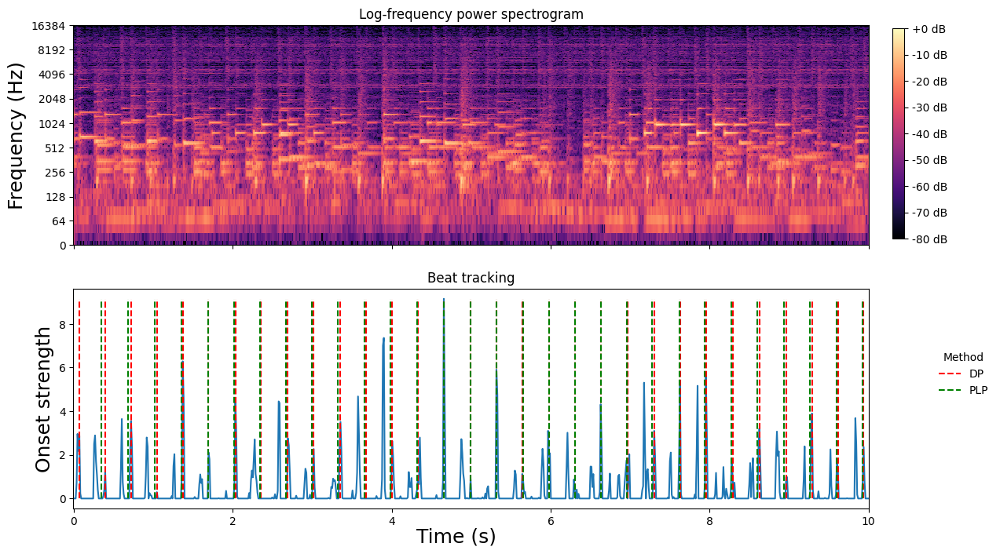

In [ ]:
# Create an instance of the OnsetStrengthTrackedBeatsPlot class, which is designed
# to generate a plot comparing the accuracy of detected beats using two different
# methods: dynamic programming (DP) and predominant local pulse estimation (PLP).
# We provide it with the beat tracking results from the DP and PLP methods.

os_ = OnsetStrengthTrackedBeatsPlot(
    tracked_beats_dp=full_be, tracked_beats_plp=beats_time
)

# Generate the beat tracking plot by calling the create_plot method on the
# previously created instance (os_). This will create a visual representation
# comparing the onset strength with the detected beats from DP and PLP methods.

os_.create_plot()


>**Beat Tracking Results Analysis: Choosing the Right Algorithm**



After analyzing the results, we've noticed that the dynamic programming algorithm closely aligns with the rhythmic peaks as we can visually observe in the graph above. Moving forward, we've decided to use the outcomes from this algorithm. However, we remain open to refining our choice of algorithm and the parameters we provide as we continue developing the full implementation.

## Improving Communication with Music Analysis

Our project aims to improve how computers understand different languages, making it easier for people from diverse backgrounds to communicate effectively. As part of this effort, we're delving into a task that's different from our earlier work on tracking the rhythm of music.

## 4. DETECTING MUSICAL NOTES IN ISOLATED TRACKS

Now, we're diving deeper into the music. We want to automatically find the exact moments when each instrument, like the piano or bass, starts playing a note. Think of it as catching every musical detail, not just the main beat.

In the code below, we use some settings like fmin and fmax to focus on specific parts of the music. These settings were chosen after looking closely at the music's patterns. Our goal is to separate the sounds of different instruments so that they don't mix together. For example, if the bass guitar's sound accidentally blends with the drumbeat, we're excluding the low notes to prevent that.

### Spotting the Start of the Drumbeat 🥁

Now, let's zoom in on the drum set. Among all the drums and cymbals, we're paying special attention to the ride cymbal because it helps us know the tempo of the music. In this recording, the ride cymbal's sound mostly falls in the higher part of the music, roughly between 2500 and 11000 Hz. We've set things up to focus on this range, making sure we capture this important part of the rhythm.

In [ ]:
# Combine the left and right channels of our stereo track into a single mono track
drums_mono = prediction_for['drums'].mean(axis=1)

# Create an onset envelope to detect the rhythm changes in the mono drum track
onset_envelope = librosa.onset.onset_strength(
    y=drums_mono,        # The mono drum track
    sr=SAMPLE_RATE,      # The sample rate of the audio
    center=False,        # Don't center the onset detection
    fmin=2500,           # The lowest frequency related to the ride cymbal
    fmax=11000,          # The highest frequency related to the ride cymbal
    max_size=10          # The size (in frequency bins) of the local maximum filter
)


In [ ]:
# Detect rhythm onsets in the drum track using the onset envelope
drum_onsets = librosa.onset.onset_detect(
    y=drums_mono,          # The mono drum track
    sr=SAMPLE_RATE,        # The sample rate of the audio
    hop_length=HOP_LENGTH, # The time interval to check for onsets
    units='time',          # Express the results in units of time
    onset_envelope=drms_oe # Use the previously created onset envelope
)

NameError: ignored

Create audio clicks to mark the detected rhythm onsets in the drum track

In [ ]:
# We're making little sound marks (clicks) to highlight where we found the rhythm onsets in the drum track.
# These clicks will help us hear the precise moments when the drummer plays the beats.
# We're ensuring that the clicks match the timing and speed of the original drum track.

# Create audio clicks at the moments we found rhythm onsets in the drum track.
drum_clicks = librosa.clicks(
    times=drms_be,          # Specify when to generate clicks (onset times)
    sr=SAMPLE_RATE,             # Set the click quality to match the music's rate
    length=drms.shape[0]  # Ensure clicks match the drum track's length
)

# Now, combine the original drum track with these clicks.
# This results in an improved version of the rhythm with audible markers
# highlighting where the drum beats occur.
Audio(drms + drms_clicks, rate=SAMPLE_RATE)

### Piano track 🎹
We concentrate on the mid-range frequency band, from 100 to 4000 Hz, when detecting onsets in the piano performance.

In [ ]:
keys = prediction_for['piano'].mean(axis=1)
keys_oe = librosa.onset.onset_strength(
    y=keys,
    sr=SAMPLE_RATE,
    hop_length=HOP_LENGTH,
    center=False,
    fmin=100, # The approximate minimum piano frequency
    fmax=4000, # The approximate maximum piano frequency
)

In [ ]:
keys_be = librosa.onset.onset_detect(
    y=keys,
    sr=SAMPLE_RATE,
    hop_length=HOP_LENGTH,
    units='time',
    onset_envelope=keys_oe
)

In [ ]:
keys_clicks = librosa.clicks(
    times=keys_be, sr=SAMPLE_RATE, length=keys.shape[0]
)
Audio(keys + keys_clicks, rate=SAMPLE_RATE)

### Bass track 🎻
Most of the energy for the bass is concentrated in the lower frequency range, from about 50 to 2000 Hz, so we can concentrate the onset detection on this region.

In [ ]:
bass = prediction_for['bass'].mean(axis=1)
bass_oe = librosa.onset.onset_strength(
    y=bass,
    sr=SAMPLE_RATE,
    hop_length=HOP_LENGTH,
    fmin=50,    # The approximate minimum bass frequency
    fmax=2000,    # The approximate maximum bass frequency
    max_size=1100,   # This helps reduce the frequency of false detections
    center=False,
    detrend=True
)

In [ ]:
bass_be = librosa.onset.onset_detect(
    y=bass,
    sr=SAMPLE_RATE,
    units='time',
    onset_envelope=bass_oe
)

In [ ]:
bass_clicks = librosa.clicks(
    times=bass_be, sr=SAMPLE_RATE, length=bass.shape[0]
)
Audio(bass + bass_clicks, rate=SAMPLE_RATE)

Ok, while those detected onsets definitely aren't perfectly aligned with the performances, they do capture enough information to work for now as a proof of concept. In particular, future refinements will aim to increase the precision of the piano (we're missing out quite a few onsets in the faster passages) and bass (again, a few onsets missed) detection. Note that any 'repeat' onsets -- e.g. where one bass note is captured twice in quick succession -- will be filtered later on. We may want to refine this in the future, so they're not present, however.

## 4. Data preparation
We now need to carry out a cleaning procedure to get our data into the correct form for modelling. This involves matching onsets detected in each individual isolated track with the metrical grid of crotchet beats extracted from the full stereo file, and coercing the data into the correct format for modelling (e.g. by extracting inter-onset intervals).

### Match detected onsets with tracked metrical grid

In [ ]:
def onset_matcher(
    ons: np.float32, ins: np.array,
) -> np.float32:
    """
    This function tries to match an estimated crotchet beat position (estimated from the full stereo mix)
    with the nearest onset played by one performer (estimated from the source-seperated track).

    If a close match cannot be found, i.e. it's above a set threshold, we set this data to missing. In this
    case, either the onset detection algorithm did not pick up this onset, or the musician did not play
    on that beat.

    By default, our threshold (set as a constant) is a 16th note, equivalent to 81 milliseconds at the
    set tempo of 180 beats-per-minute.
    """

    # Get our closest match from our array of detected onsets
    v = ins[np.abs(ins - ons).argmin()]
    # Calculate our detection threshold
    threshold = ((60 / average_tempo) * 4) * note_detection_threshold
    # Return our onset if it's below our threshold, else return NaN
    return v if np.abs(v - ons) <= threshold else np.nan

In [ ]:
def matcher_helper(
    ons: float
) -> dict:
    """
    A simple helper function that runs onset_matcher for a single onset for every performer, i.e. once
    for bass, drums, and keys, and then returns a dictionary.
    """

    return {
        'onset': ons,
        'keys_match': onset_matcher(ons, keys_be),
        'bass_match': onset_matcher(ons, bass_be),
        'drms_match': onset_matcher(ons, drms_be)
    }

# Create the dataframe
df = pd.DataFrame([matcher_helper(ons) for ons in full_be])

### Coerce the data into the correct format

In [ ]:
def data_coerce(
    y_ins: str, x_ins: list[str]
) -> pd.DataFrame:
    """
    This function simply coerces the data for one performer into the correct format by creating new columns.
    The new columns correspond to:

    - instrument1_prev_ioi: the inter-onset interval between the current and the previous onset
    - instrument1_next_ioi: the inter-onset interval between the current and the *next* onset
    - instrument1_instrument2_asynchrony: the asynchrony between the two instruments at the current onset
    """

    # Compile the inter-onset intervals
    dic = {
        f'{y_ins}_prev_ioi': df[f'{y_ins}_match'].diff(),
        f'{y_ins}_next_ioi': df[f'{y_ins}_match'].diff().shift(-1),
    }
    # Update the dictionary with our asynchrony values
    dic.update({
        f'{y_ins}_{ins}_asynchrony': df[f'{ins}_match'] - df[f'{y_ins}_match'] for ins in x_ins
    })
    # Return the dictionary as a dataframe
    return pd.DataFrame(dic)

In [ ]:
# Concatenate our original dataframe with the new columns we need each for the piano, drummer, and bassist
df_conc = pd.concat(
    [
        df,
        data_coerce('drms', ['keys', 'bass']),
        data_coerce('keys', ['drms', 'bass']),
        data_coerce('bass', ['drms', 'keys'])
    ],
    axis=1
)

## 5. Phase correction modelling
Now we have the data in the correct format, we can begin to create our model. This is a linear phase correction model (Vorberg & Wing, 1996), which predicts the duration of future inter-onset intervals by a performer from both the duration of prior inter-onset intervals by that same performer and the asynchrony between their’s and their partner’s previous onset (Jacoby et al., 2021).

### Generate the model

In [ ]:
def gen_model(
    y_ins: str, x_ins: list[str]
):
    """
    This function takes in the name of one instrument (y_ins) and the remaining two instruments (x_ins), then
    constructs the model in the required format and returns the OLSResults object
    """

    # Format our asynchrony (coupling) terms in the model
    x_ins = '+'.join(f'{y_ins}_{ins}_asynchrony' for ins in x_ins)
    # Format the rest of our model
    md = f'{y_ins}_next_ioi~{y_ins}_prev_ioi+' + x_ins
    # Create the regression model, fit to the data, and return
    return smf.ols(md, data=df_conc).fit()

In [ ]:
# Generate our regression models for each instrument
mds = [
    gen_model('drms', ['keys', 'bass']),
    gen_model('keys', ['drms', 'bass']),
    gen_model('bass', ['keys', 'drms'])
]

In [ ]:
# Extract the coupling responses from the model parameters
coefs = {
    p: c for md in mds for p, c in md.params.to_dict().items() if 'asynchrony' in p
}

In [ ]:
# Coerce the coupling responses into a dataframe
df_coefs = pd.DataFrame(coefs.items(), columns=['ins', 'coupling'])
df_coefs[['influenced', 'influencer', '_']] = df_coefs['ins'].str.split('_', expand=True)
df_coefs = df_coefs.drop(columns=['ins', '_']).sort_values(by='influencer')

## 6. Visualise the coupling responses between musicians
We now create a graph that shows visually the modelled coupling responses between the three musicians. This plot is similar to Figure 3b. in Jacoby et al (2021). The direction of arrows on our plot indicates the influence and influencer instruments, namely the tendency of one performer to follow (and adapt to) the indicated instrument: the thickness and colour of the arrows indicate the strength of this coupling.

In [ ]:
# Here, we pull in the image files we're going to use to display on our graph
!wget -O ./assets/bill.jpg https://github.com/HuwCheston/source-seperation-test/raw/main/assets/bill.jpg
!wget -O ./assets/scott.jpg https://github.com/HuwCheston/source-seperation-test/raw/main/assets/scott.jpg
!wget -O ./assets/paul.jpg  https://github.com/HuwCheston/source-seperation-test/raw/main/assets/paul.jpg
!wget -O ./assets/cover.jpg  https://github.com/HuwCheston/source-seperation-test/raw/main/assets/cover.jpg

In [ ]:
class PhaseCorrectionPlot:
    """
    This class generates a plot where showing the measured couplings between each musician in the recording.
    The direction of arrows indicates the influence and influencer instruments, namely the tendency of one performer
    to follow (and adapt to) the indicated instrument: the thickeness and colour of the arrows indicate the strength
    of this coupling.

    NB. This graph is similar to Figure 3b. in Jacoby et al. (2021)
    """
    def __init__(self, **kwargs):
        plt.rcParams.update({'font.size': 18})
        self.df = kwargs.get('df', df_coefs)
        self.fig, self.ax = plt.subplots(nrows=1, ncols=1, sharex=False, sharey=False, figsize=(10, 10))
        self.ax.axis('off')
        self.ax.set_aspect('equal')
        self.colors = ['red', 'blue', 'green']

    def create_plot(
        self
    ) -> None:
        """
        Called from outside the class to generate the required plot elements, show them, and save in the assets folder
        """

        self._add_musicians_images()
        self._add_cover_image()
        self._add_extra_text()
        self._create_plot()
        plt.show()
        self.fig.savefig(r'./output/modelled_coupling.png', facecolor='white')

    def _create_plot(
        self, arrow_mod: float = 25
    ) -> None:
        """
        Creates the plot arrows and annotations, according to the modelled coupling responses.
        The arrow_mod argument is the scaling applied to the coupling coefficient, used to set the correct width of the arrows.
        """

        instruments = ['bass', 'drms', 'keys']
        # The starting coordinate for each arrow, i.e. the arrow tail
        start_coords = [
            [(0.35, 0.95), (0.725, 0.175)],
            [(0.15, 0.325), (0.85, 0.325)],
            [(0.65, 0.95), (0.275, 0.075)],
        ]
        # The end coordinate for each arrow, i.e. the arrow head
        end_coords = [
            [(0.05, 0.325), (0.275, 0.175)],
            [(0.35, 0.75), (0.65, 0.75)],
            [(0.95, 0.325), (0.725, 0.075)],
        ]

        # Iterate over each influencer instrument, their respective arrows, and the color they're associated with
        for influencer, start_coord, end_coord, col in zip(
            instruments, start_coords, end_coords, self.colors
        ):
            # Iterate over each instrument they influence, and each individual arrow
            for influenced, (x, y), (x2, y2) in zip(
                [i for i in instruments if i != influencer], start_coord, end_coord
            ):
                # Get our coupling coefficient
                subs = self._get_coupling_coefficient(influenced, influencer)
                # Add in the arrow
                self.ax.annotate(
                    '', xy=(x, y), xycoords=self.ax.transAxes,
                    xytext=(x2, y2), textcoords=self.ax.transAxes,
                    arrowprops=dict(
                        width=arrow_mod * subs, edgecolor=col, lw=1.5, facecolor=col, headwidth=20
                    )
                )
                self._add_coupling_constant(subs, x, x2, y, y2)

    def _get_coupling_coefficient(
        self, influenced: str, influencer: str
    ) -> float:
        """
        Helper function to get the coupling coefficient between two instruments,
        the influencer and influenced.
        """

        return self.df[
            (self.df['influencer'] == influenced) &
            (self.df['influenced'] == influencer)
        ]['coupling'].iloc[0]


    def _add_coupling_constant(
        self, constant, x, x2, y, y2, mod: float = 0.03
    ) -> None:
        """
        Adds coupling coefficient
        """

        # Get the default annotation position, the midpoint of our arrow
        x_pos = (x + x2) / 2
        y_pos = (y + y2) / 2
        # Bottom of plot
        if y_pos < 0.3:
            y_pos += mod
        # Top left of plot
        elif x_pos < 0.5:
            y_pos += mod
            x_pos -= (mod * 1.1)
        # Right of plot
        elif x_pos > 0.5:
            y_pos += mod
            x_pos += (mod * 1.1)
        # Add in the text using the x and y position
        self.ax.text(
            x_pos, y_pos, round(abs(constant), 2), ha='center', va='center', fontsize=14
        )

    def _add_cover_image(
        self
    ) -> None:
        """
        Adds in the album cover artwork to the plot
        """

        # Read the image and add it to the plot
        img = plt.imread(r'/content/assets/cover.jpg')
        img = mpl.offsetbox.OffsetImage(img, zoom=0.5)
        ab = mpl.offsetbox.AnnotationBbox(
            img, (0.5, 0.5), xycoords='data',
            bboxprops=dict(edgecolor='black', boxstyle='sawtooth', lw=2)
        )
        self.ax.add_artist(ab)
        # Add in the caption to the album artwork
        txt = """$Peri's$ $Scope$ (1959)\nRhythmic adaptation\nbetween musicians"""
        self.ax.text(0.5, 0.325, txt, ha='center', va='center', fontsize=15)

    def _add_musicians_images(
        self
    ) -> None:
        """
        Adds images corresponding to each performer in the trio
        """

        # Iterate through the position for each picture, the amount of zoom,
        # the name of the performer, and the colour of the box around the picture
        for (x, y), zoom, txt, col  in zip(
            [(0.125, 0.125), (0.5, 0.875), (0.867, 0.133),],
            [.68, .6375, .75,],
            ['Scott LaFaro (bass)', 'Paul Motian\n(drums)', 'Bill Evans (piano)',],
            self.colors
        ):
            # Get the filepath from the performer's name
            mus = txt.split(' ')[0].lower()
            # Display the image
            img = plt.imread(fr'/content/assets/{mus}.jpg')
            img = mpl.offsetbox.OffsetImage(img, zoom=zoom)
            ab = mpl.offsetbox.AnnotationBbox(
                img, (x, y), xycoords='data', bboxprops=dict(edgecolor=col, lw=2)
            )
            self.ax.add_artist(ab)
            # Add the text in, adjacent to the image
            self.ax.text(
                x, y + 0.15 if y < 0.5 else y - 0.175,
                txt, ha='center', va='center', color=col
            )

    def _add_extra_text(
        self
    ) -> None:
        """
        Adds some additional extra text into the plot, e.g. titles, descriptions
        """
        txt = """Modelling interaction in the\njazz rhythm section using \nsource-seperated commercial\naudio recordings"""
        self.ax.text(-0.05, 0.9, txt, fontsize=12, ha='left', va='center', fontstyle='italic')
        txt = """Proof of Concept"""
        self.ax.text(-0.05, 0.8, txt, fontsize=12, ha='left', va='center', fontweight='bold')
        txt = """Direction of arrows indicate the\ntendency of one performer\nto follow (adapt to) another;\nthickness and colour of the\narrows indicate coupling\nstrength."""
        self.ax.text(1.05, 0.875, txt, fontsize=12, ha='right', va='center',)

In [ ]:
vis = PhaseCorrectionPlot(df=df_coefs)
vis.create_plot()

Even from the small, 30-second excerpt we've used here, the graph above shows some interesting details. Namely, both the bass and drums are tightly coupled to each other, but not to the piano soloist. The piano, meanwhile, couples strongly to both the bass and drums. In this sense, rhythmic adaptation is orientated towards the bass and drums comping, which provides an anchor for the piano improvisations.